In [2]:
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import pandas as pd
import numpy as np
import os

Data Path

In [21]:
curr_dir = os.getcwd()
raw_data_dir = 'Rawdata'
raw_data_name = 'Customer Data.csv'
raw_data_path = os.path.join(curr_dir, raw_data_dir, raw_data_name)

print(curr_dir)
print(raw_data_path)

d:\FIBO\Bachelor\3rd_Year\1st_Semester\Machine_Learning_Project
d:\FIBO\Bachelor\3rd_Year\1st_Semester\Machine_Learning_Project\Rawdata\Customer Data.csv


In [22]:
raw_data = pd.read_csv(raw_data_path)
raw_data.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


<AxesSubplot: xlabel='CREDIT_LIMIT', ylabel='Count'>

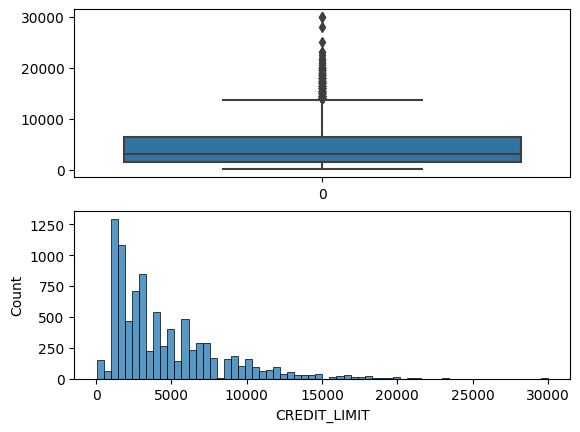

In [231]:
plt1 = plt.subplot(211)
sns.boxplot(raw_data['CREDIT_LIMIT'])
plt2 = plt.subplot(212)
sns.histplot(raw_data['CREDIT_LIMIT'])

<AxesSubplot: xlabel='PURCHASES', ylabel='Count'>

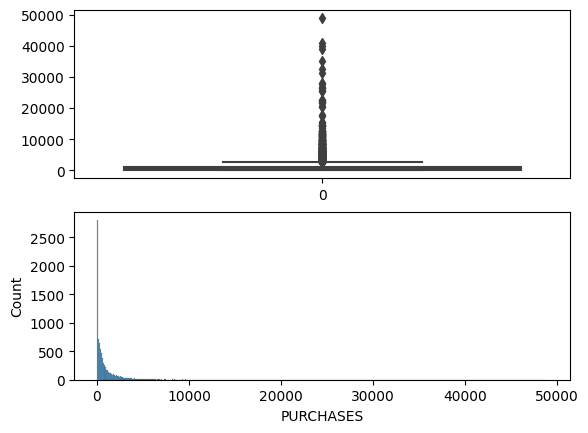

In [232]:
plt1 = plt.subplot(211)
sns.boxplot(raw_data['PURCHASES'])
plt2 = plt.subplot(212)
sns.histplot(raw_data['PURCHASES'])

In [5]:
from sklearn.cluster import KMeans
from sklearn import metrics

Function for Machine Learning Process

In [103]:
def k_means_n_cluster_tuner(data, k_cluster=9):
    Num_K = range(2, int(k_cluster)+1)
    silhouette_coef = []
    slope = []
    WCSS = []
    count = 0
    flag = True

    for k in Num_K:
        kmeans = KMeans(n_clusters=k, random_state=1,)
        model = kmeans.fit(data)
        WCSS.append(model.inertia_)
        labels = model.labels_
        silhouette_coef.append(metrics.silhouette_score(data, labels, metric='euclidean'))
        if (count > 1):
            slope.append(abs(model.inertia_ - last_WCSS))
        count += 1
        last_WCSS = model.inertia_
    slope = np.array(slope)/max(slope)
    diff = (np.diff(slope)).tolist()
    med = np.median(np.array(silhouette_coef))
    print(med)
    for i in diff:
        if ((i > -0.2) and (silhouette_coef[Num_K.index(diff.index(i) + 2)] >= med) and (flag == True)):
            res = diff.index(i) + 2
            flag = False

    return res, WCSS, silhouette_coef, list(Num_K)

In [7]:
def k_means_model_builder(data, k_cluster=9):
    kmeans = KMeans(n_clusters=k_cluster, random_state=1,)
    model = kmeans.fit(data)
    return model

In [8]:
def create_cluster(model, test, data):
    label = pd.DataFrame(model.predict(test), columns = ["cluster_class"])
    label.describe()
    ct_set = pd.concat([data, label], axis=1)
    return ct_set

In [9]:
def model_result_pairplot(data, label):
    sns.pairplot(data, hue=label)

In [10]:
def model_result_linepolar(data, label):
    plot = pd.melt(data, id_vars=[label])
    fig = px.line_polar(plot, r="value", theta="variable", color=label, line_close=True)
    fig.show()

In [109]:
column = ["BALANCE", "PURCHASES", "PURCHASES_TRX", "ONEOFF_PURCHASES_FREQUENCY", "ONEOFF_PURCHASES", "PAYMENTS"]
test = raw_data[column].copy()

In [110]:
test.isna().sum().sum()

0

In [111]:
test.dropna(inplace=True)
test = test.reindex()

In [112]:
std_test = test.copy()
std_test.describe()

,BALANCE,PURCHASES,PURCHASES_TRX,ONEOFF_PURCHASES_FREQUENCY,ONEOFF_PURCHASES,PAYMENTS
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,1564.474828,1003.204834,14.709832,0.202458,592.437371,1733.143852
std,2081.531879,2136.634782,24.857649,0.298336,1659.887917,2895.063757
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,128.281915,39.635000,1.000000,0.000000,0.000000,383.276166
50%,873.385231,361.280000,7.000000,0.083333,38.000000,856.901546
75%,2054.140036,1110.130000,17.000000,0.300000,577.405000,1901.134317
max,19043.138560,49039.570000,358.000000,1.000000,40761.250000,50721.483360


In [113]:
best_n_cluster, wcss_score, sh_coef, k_list = k_means_n_cluster_tuner(std_test)

0.5265449438058586


In [114]:
print(k_list)
print(wcss_score)
print(sh_coef)

[2, 3, 4, 5, 6, 7, 8, 9]
[120198217934.70172, 90195787169.87521, 69843493836.64133, 58041267074.79941, 49188455135.726265, 43050181728.651184, 38395287608.8485, 34647067041.63291]
[0.7409278186581083, 0.6367920180840754, 0.5409301876718284, 0.544328032886751, 0.5121596999398887, 0.4831779001340621, 0.4206439202791009, 0.4148623924154371]


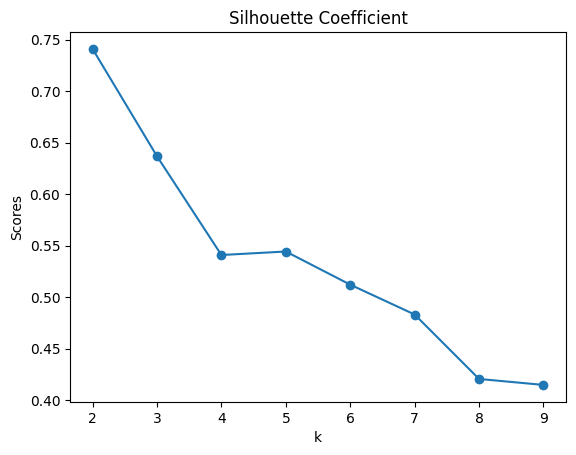

In [115]:
plt.scatter(k_list, sh_coef)
plt.plot(k_list, sh_coef)
plt.title('Silhouette Coefficient')
plt.ylabel('Scores')
plt.xlabel('k')
plt.show()

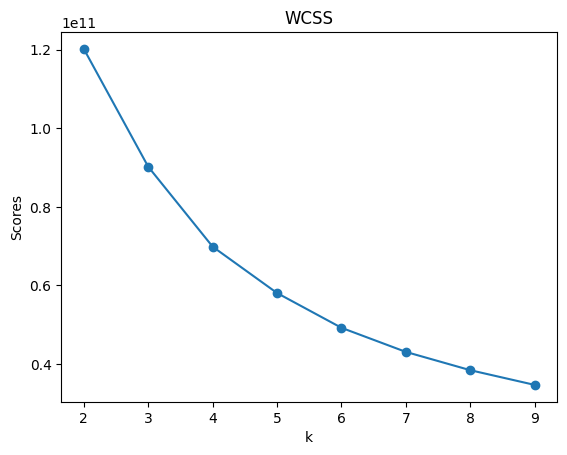

In [116]:
plt.scatter(k_list, wcss_score)
plt.plot(k_list, wcss_score)
plt.title('WCSS')
plt.ylabel('Scores')
plt.xlabel('k')
plt.show()

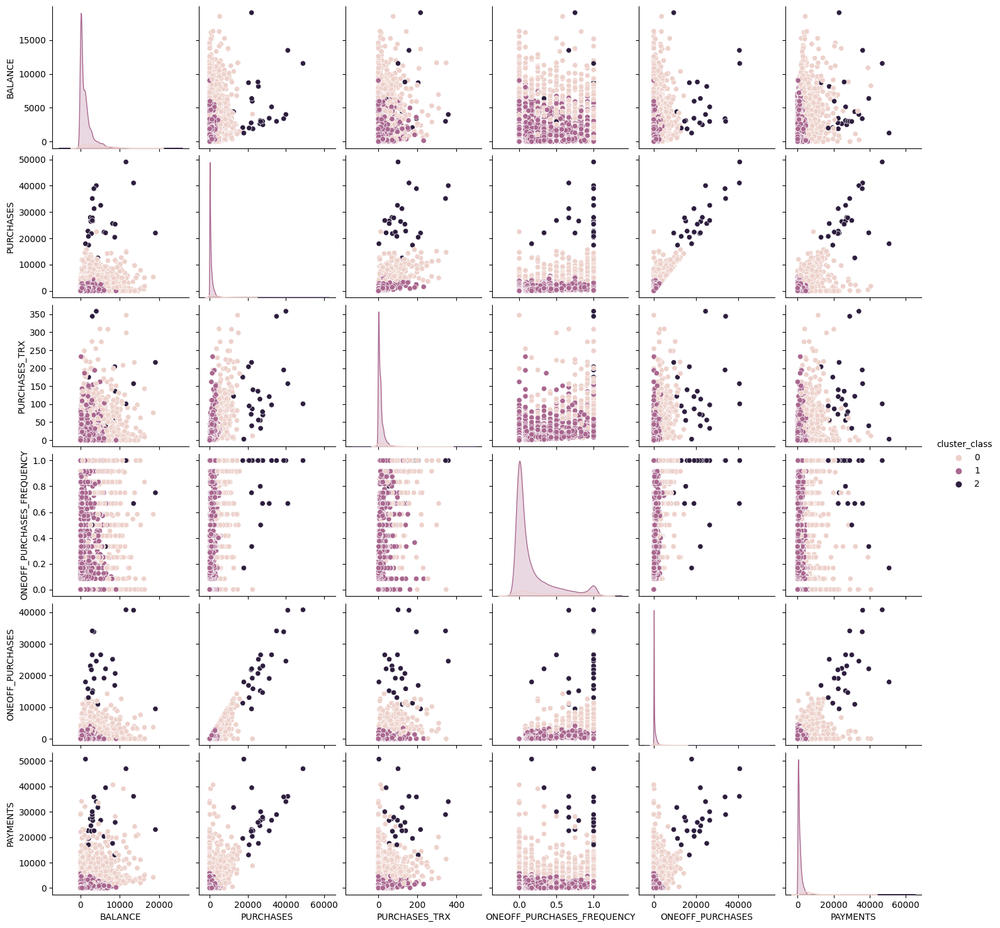

In [117]:
kmeans_model = k_means_model_builder(std_test, best_n_cluster)
test_cluster = create_cluster(kmeans_model, std_test, std_test)
model_result_pairplot(test_cluster, "cluster_class")

In [121]:
test_cluster['cluster_class'].value_counts()

1    7876
0    1050
2      24
Name: cluster_class, dtype: int64

In [240]:
data_explo1 = pd.concat([raw_data['CREDIT_LIMIT'], raw_data['PURCHASES']], axis=1)
print(data_explo1.isna().sum().sum())
data_explo1.describe()

0


,CREDIT_LIMIT,PURCHASES
count,8636.000000,8636.000000
mean,4522.091030,1025.433874
std,3659.240379,2167.107984
min,50.000000,0.000000
25%,1600.000000,43.367500
50%,3000.000000,375.405000
75%,6500.000000,1145.980000
max,30000.000000,49039.570000


In [214]:
data_explo1 = np.sqrt(data_explo1)
data_explo1.describe()

,CREDIT_LIMIT,PURCHASES
count,8636.000000,8636.000000
mean,62.315010,23.172838
std,25.278540,22.102263
min,7.071068,0.000000
25%,40.000000,6.585400
50%,54.772256,19.375370
75%,80.622577,33.852326
max,173.205081,221.448798


In [234]:
clear_data_explo1 = (data_explo1.dropna()).copy()
print(clear_data_explo1.isna().sum().sum())
clear_data_explo1.describe()

0


,CREDIT_LIMIT,PURCHASES
count,8949.000000,8949.000000
mean,4494.449450,1003.316936
std,3638.815725,2136.727848
min,50.000000,0.000000
25%,1600.000000,39.800000
50%,3000.000000,361.490000
75%,6500.000000,1110.170000
max,30000.000000,49039.570000


-0.4723598126637565
-0.08433606645887548


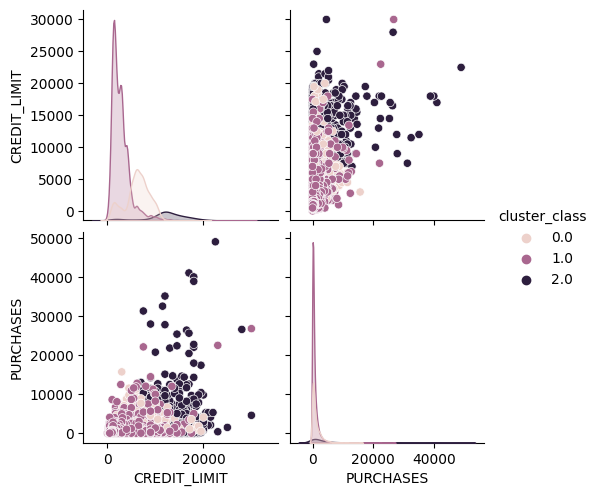

In [274]:
best_n_cluster = k_means_n_cluster_tuner(clear_data_explo1)
kmeans_model = k_means_model_builder(clear_data_explo1, best_n_cluster)
cluster = create_cluster(kmeans_model, clear_data_explo1, clear_data_explo1)
model_result_pairplot(cluster, "cluster_class")

In [252]:
raw_data.isna().sum().sum()
raw_data.dropna(inplace=True)
raw_data.isna().sum().sum()
new_data = raw_data.drop(['CUST_ID'], axis=1)
new_data = create_cluster(kmeans_model, clear_data_explo1, new_data)
new_data.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE', 'cluster_class'],
      dtype='object')

<AxesSubplot: >

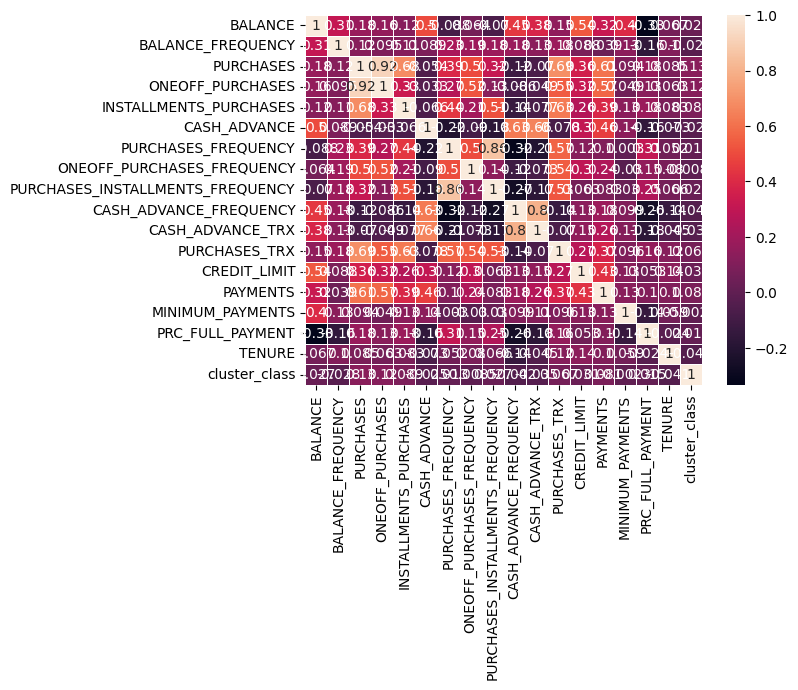

In [253]:
corr_new_data = new_data.corr()
sns.heatmap(corr_new_data, annot=True, linewidth=.5)

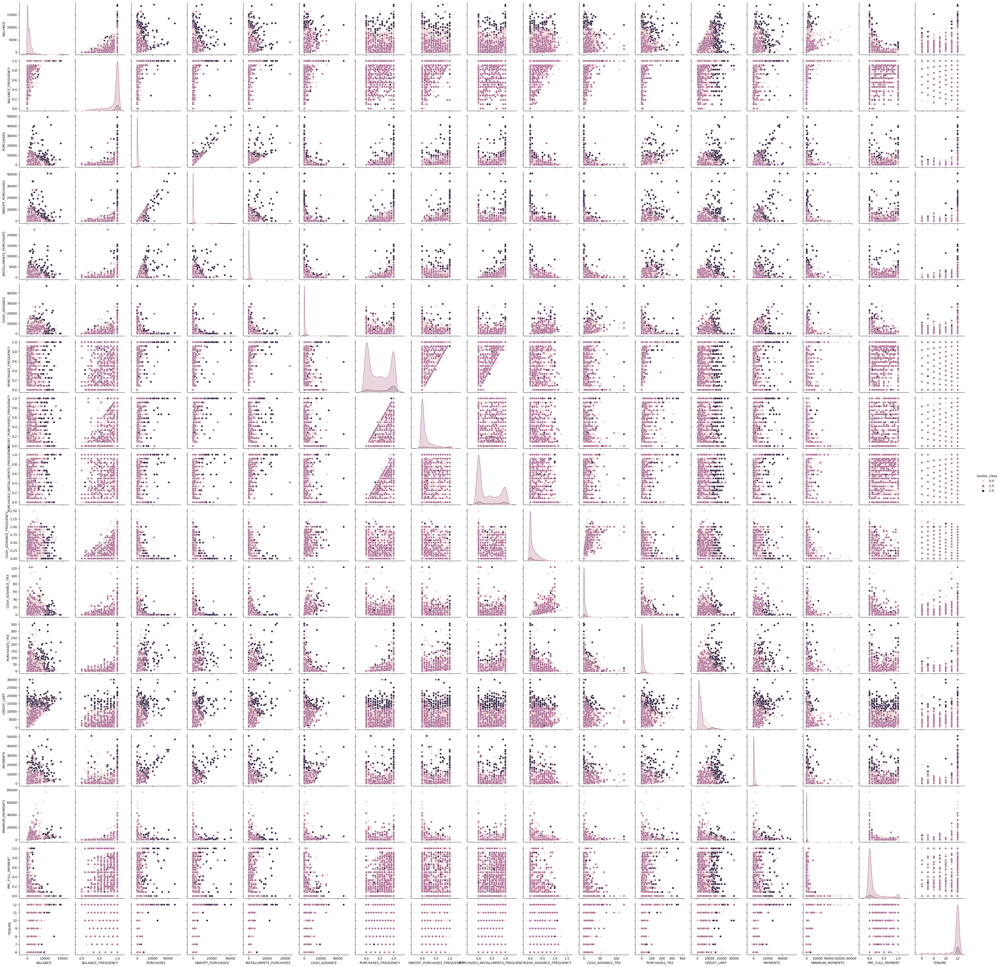

In [254]:
model_result_pairplot(new_data, "cluster_class")

In [265]:
data_explo2 = pd.concat([raw_data['PAYMENTS'], raw_data['PURCHASES'], raw_data['CREDIT_LIMIT']], axis=1)
print(data_explo2.isna().sum().sum())
data_explo2.describe()

0


,PAYMENTS,PURCHASES,CREDIT_LIMIT
count,8636.000000,8636.000000,8636.000000
mean,1784.478099,1025.433874,4522.091030
std,2909.810090,2167.107984,3659.240379
min,0.049513,0.000000,50.000000
25%,418.559237,43.367500,1600.000000
50%,896.675701,375.405000,3000.000000
75%,1951.142090,1145.980000,6500.000000
max,50721.483360,49039.570000,30000.000000


In [267]:
clear_data_explo2 = (data_explo2.dropna()).copy()
print(clear_data_explo2.isna().sum().sum())
clear_data_explo2.describe()

0


,PAYMENTS,PURCHASES,CREDIT_LIMIT
count,8636.000000,8636.000000,8636.000000
mean,1784.478099,1025.433874,4522.091030
std,2909.810090,2167.107984,3659.240379
min,0.049513,0.000000,50.000000
25%,418.559237,43.367500,1600.000000
50%,896.675701,375.405000,3000.000000
75%,1951.142090,1145.980000,6500.000000
max,50721.483360,49039.570000,30000.000000


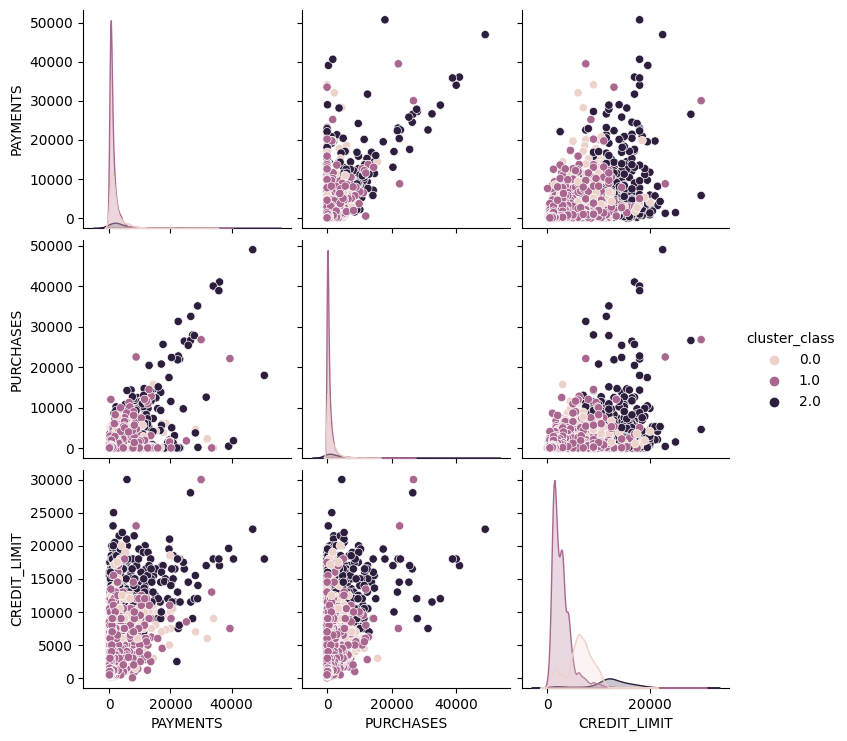

In [275]:
cluster = create_cluster(kmeans_model, test=clear_data_explo1, data=pd.concat([raw_data['PAYMENTS'], raw_data['PURCHASES'], raw_data['CREDIT_LIMIT']], axis=1))
model_result_pairplot(cluster, "cluster_class")

In [276]:
model_result_linepolar(cluster, "cluster_class")

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



-0.18509776240412168


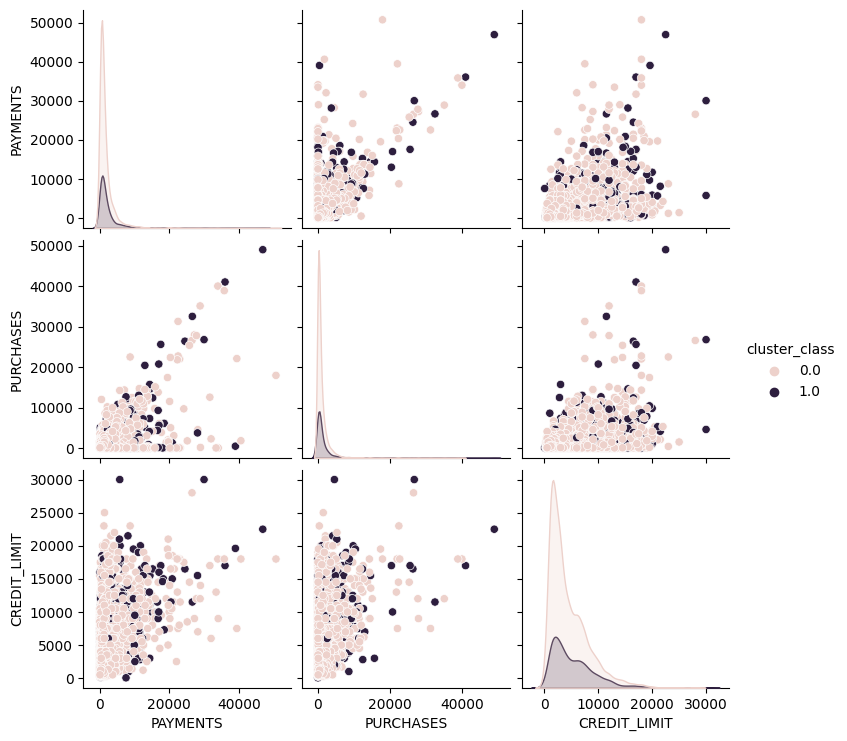

In [277]:
best_n_cluster = k_means_n_cluster_tuner(clear_data_explo2)
kmeans_model = k_means_model_builder(clear_data_explo2, best_n_cluster)
cluster = create_cluster(kmeans_model, clear_data_explo2, clear_data_explo2)
model_result_pairplot(cluster, "cluster_class")

In [ ]:
data_explo3 = pd.concat([raw_data['PAYMENTS'], raw_data['PURCHASES'], raw_data['CREDIT_LIMIT']], axis=1)
print(data_explo3.isna().sum().sum())
data_explo3.describe()

0


,PAYMENTS,PURCHASES,CREDIT_LIMIT
count,8636.000000,8636.000000,8636.000000
mean,1784.478099,1025.433874,4522.091030
std,2909.810090,2167.107984,3659.240379
min,0.049513,0.000000,50.000000
25%,418.559237,43.367500,1600.000000
50%,896.675701,375.405000,3000.000000
75%,1951.142090,1145.980000,6500.000000
max,50721.483360,49039.570000,30000.000000


In [ ]:
new_data = create_cluster(kmeans_model, clear_data_explo1, new_data)
new_data.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE',
       'cluster_class'],
      dtype='object')

-0.18509776240411824


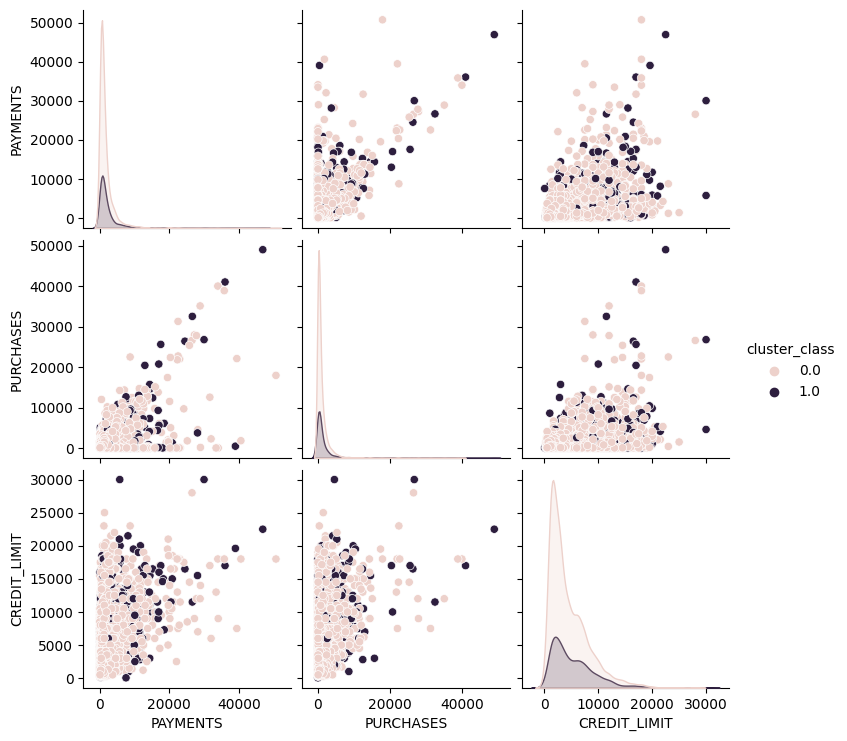

In [ ]:
best_n_cluster = k_means_n_cluster_tuner(clear_data_explo2)
kmeans_model = k_means_model_builder(clear_data_explo2, best_n_cluster)
cluster = create_cluster(kmeans_model, clear_data_explo2, clear_data_explo2)
model_result_pairplot(cluster, "cluster_class")

<AxesSubplot: >

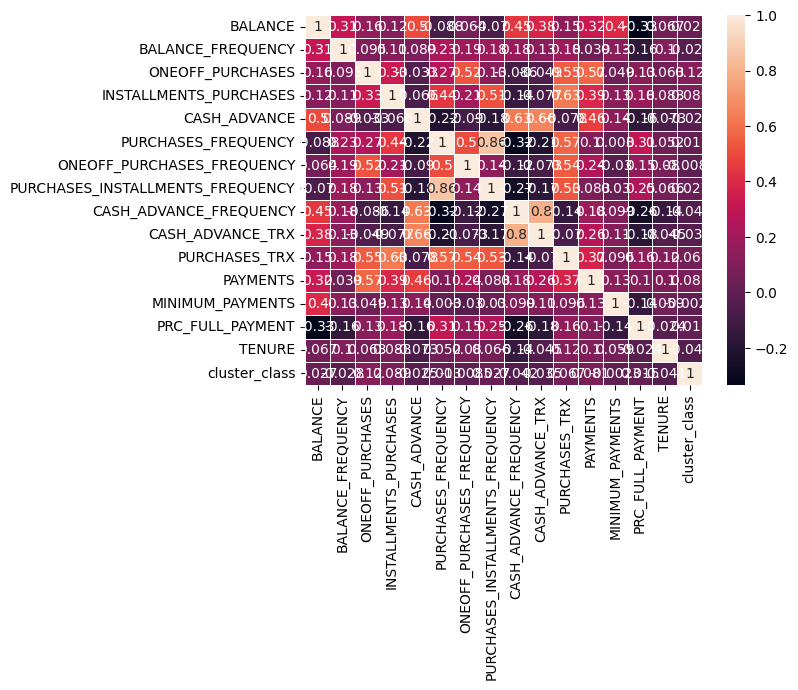

In [ ]:
corr_new_data = new_data.corr()
sns.heatmap(corr_new_data, annot=True, linewidth=.5)

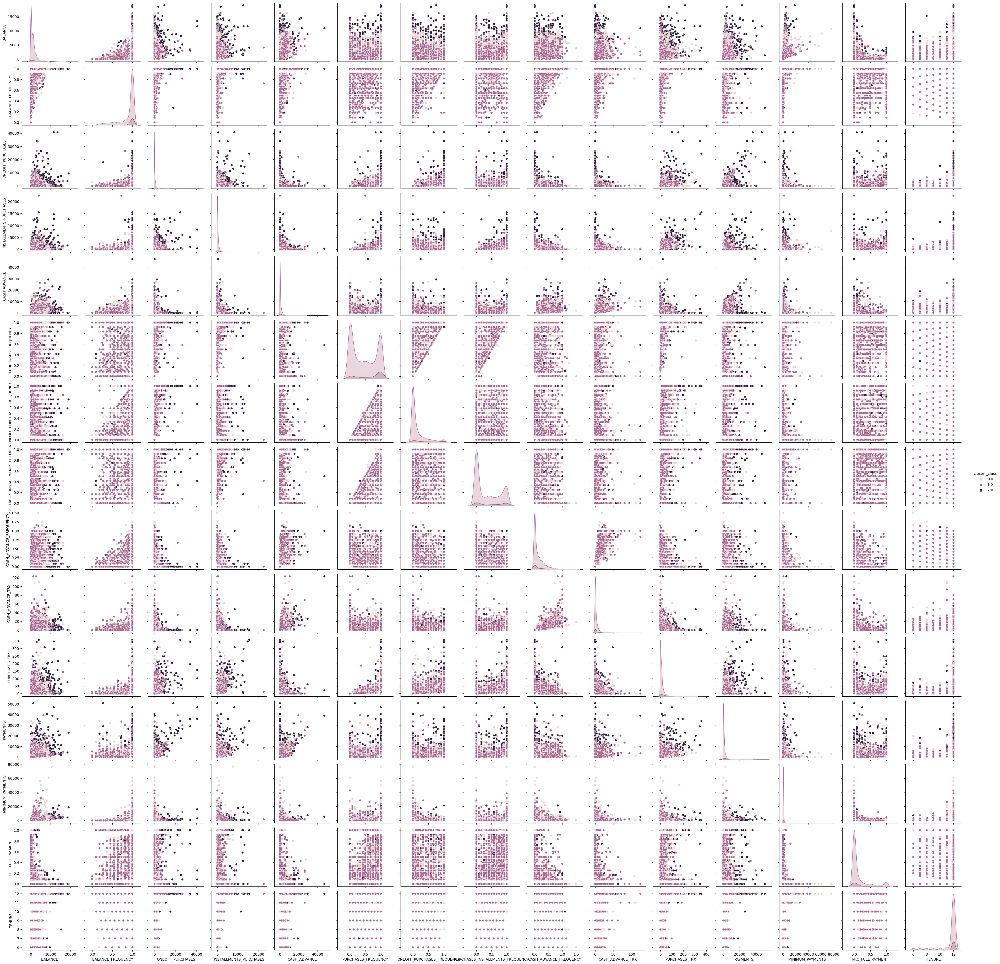

In [ ]:
model_result_pairplot(new_data, "cluster_class")

BALANCE <-> ONEOFF_PURCHASES 
BALANCE <-> INSTALLMENT_PURCHASES
BALANCE <-> PURCHASE_TRX
BALANCE <-> MINIMUM_PAYMENTS

C:\Users\newth\AppData\Local\Temp\ipykernel_18132\2149688334.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



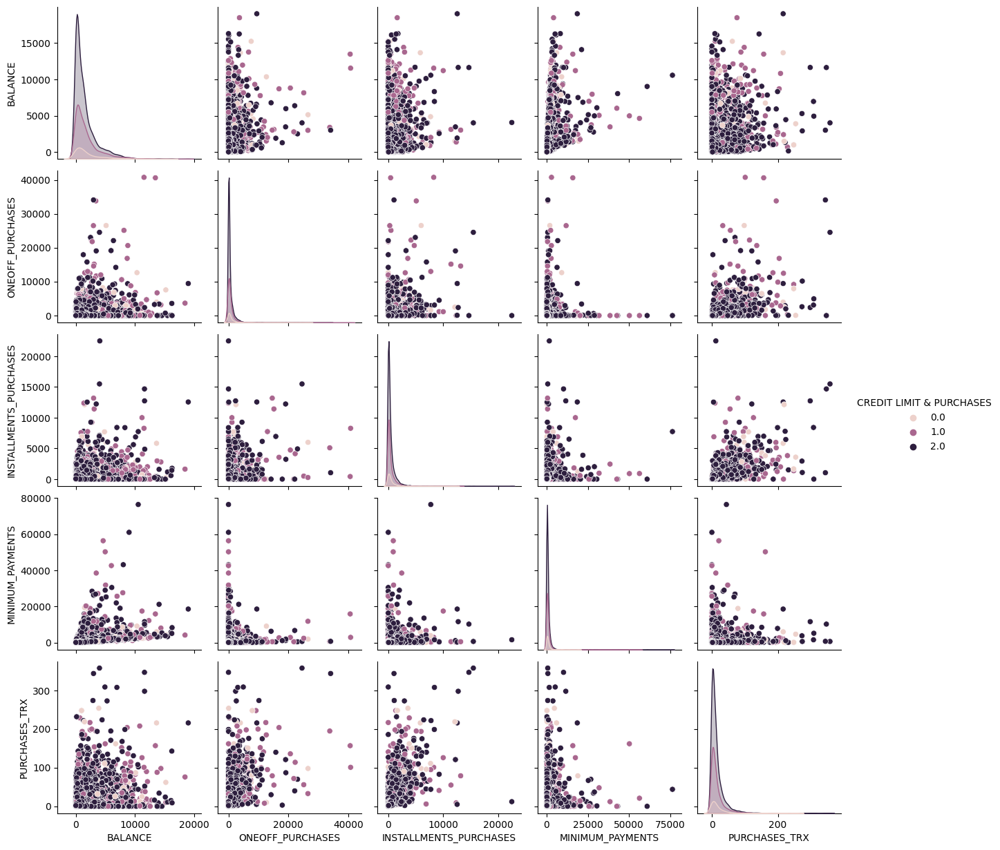

In [228]:
attractive_data_column = ['BALANCE', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'MINIMUM_PAYMENTS', 'PURCHASES_TRX', 'cluster_class']
attractive_data = new_data[attractive_data_column]
attractive_data.rename(columns={"cluster_class" : "CREDIT LIMIT & PURCHASES"}, inplace=True)
model_result_pairplot(attractive_data, "CREDIT LIMIT & PURCHASES")

In [118]:
attractive_data.describe()

,BALANCE,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,MINIMUM_PAYMENTS,PURCHASES_TRX,CREDIT LIMIT & PURCHASES
count,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8949.000000
mean,1601.224893,604.901438,420.843533,864.304943,15.033233,0.770812
std,2095.571300,1684.307803,917.245182,2372.566350,25.180468,0.569974
min,0.000000,0.000000,0.000000,0.019163,0.000000,0.000000
25%,148.095189,0.000000,0.000000,169.163545,1.000000,0.000000
50%,916.855459,44.995000,94.785000,312.452292,7.000000,1.000000
75%,2105.195853,599.100000,484.147500,825.496463,18.000000,1.000000
max,19043.138560,40761.250000,22500.000000,76406.207520,358.000000,2.000000


In [119]:
pre_data = attractive_data.drop('CREDIT LIMIT & PURCHASES', axis=1)
pre_data = np.sqrt(pre_data)
pre_data.describe()
# model_result_pairplot(pre_data, "CREDIT LIMIT & PURCHASES")

,BALANCE,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,MINIMUM_PAYMENTS,PURCHASES_TRX
count,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000
mean,32.450537,14.494954,13.239623,23.347764,2.919078
std,23.414761,19.870668,15.671132,17.866836,2.552052
min,0.000000,0.000000,0.000000,0.138430,0.000000
25%,12.169435,0.000000,0.000000,13.006289,1.000000
50%,30.279621,6.707831,9.735758,17.676320,2.645751
75%,45.882413,24.476519,22.003352,28.731454,4.242641
max,137.996879,201.894155,150.000000,276.416728,18.920888


In [120]:
attractive_data = pd.concat([pre_data, attractive_data['CREDIT LIMIT & PURCHASES']], axis=1)
onehot = pd.get_dummies(attractive_data['CREDIT LIMIT & PURCHASES'])
onehot.rename(columns={0.0 : "CREDIT LIMIT & PURCHASES is 0.0", 1.0 : "CREDIT LIMIT & PURCHASES is 1.0", 2.0 : "CREDIT LIMIT & PURCHASES is 2.0"}, inplace=True)
old_data = attractive_data.drop('CREDIT LIMIT & PURCHASES', axis=1)
training_dataset = pd.concat([old_data, onehot], axis=1)

In [121]:
training_dataset.isna().sum().sum()
training_dataset.dropna(inplace=True)
training_dataset.isna().sum().sum()

0

In [122]:
best_n_cluster = k_means_n_cluster_tuner(training_dataset)
kmeans_model = k_means_model_builder(training_dataset, best_n_cluster)
cluster = create_cluster(kmeans_model, training_dataset, training_dataset)
cluster['cluster_class'].value_counts()

-0.44429585728966714
-0.051346226655809235


1.0    5067
0.0    2214
2.0    1355
Name: cluster_class, dtype: int64

In [123]:
cluster['cluster_class'].unique()

array([ 1.,  0.,  2., nan])

In [124]:
cluster.isna().sum().sum()
cluster.dropna(inplace=True)
cluster.isna().sum().sum()

0

In [125]:
old_label = np.array(range(len(cluster['cluster_class'].unique().tolist())), dtype = float)
new_label = []
for i in range(len(cluster['cluster_class'].unique().tolist())):
    new_label.append('behavior_' + str(int(i+1)))

In [126]:
cluster['cluster_class'].replace(old_label, new_label, inplace=True)
cluster['cluster_class'].value_counts()

behavior_2    4890
behavior_1    2122
behavior_3    1327
Name: cluster_class, dtype: int64

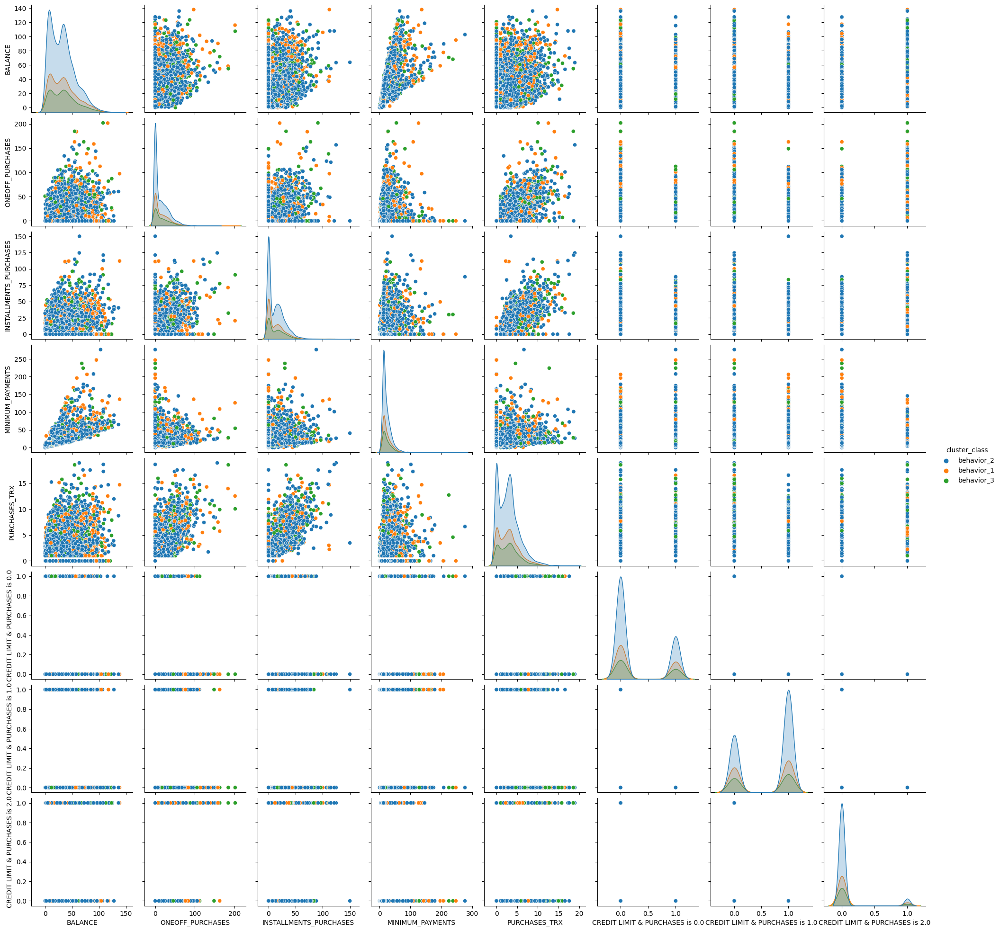

In [127]:
model_result_pairplot(cluster, "cluster_class")

In [89]:
model_result_linepolar(cluster, "cluster_class")

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [128]:
attractive_data_column = ['BALANCE', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'MINIMUM_PAYMENTS', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PURCHASES']
attractive_data = raw_data[attractive_data_column]

In [129]:
attractive_data.describe()

,BALANCE,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,MINIMUM_PAYMENTS,PURCHASES_TRX,CREDIT_LIMIT,PURCHASES
count,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000
mean,1601.224893,604.901438,420.843533,864.304943,15.033233,4522.091030,1025.433874
std,2095.571300,1684.307803,917.245182,2372.566350,25.180468,3659.240379,2167.107984
min,0.000000,0.000000,0.000000,0.019163,0.000000,50.000000,0.000000
25%,148.095189,0.000000,0.000000,169.163545,1.000000,1600.000000,43.367500
50%,916.855459,44.995000,94.785000,312.452292,7.000000,3000.000000,375.405000
75%,2105.195853,599.100000,484.147500,825.496463,18.000000,6500.000000,1145.980000
max,19043.138560,40761.250000,22500.000000,76406.207520,358.000000,30000.000000,49039.570000


In [130]:
training_dataset = np.sqrt(attractive_data)
training_dataset.describe()

,BALANCE,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,MINIMUM_PAYMENTS,PURCHASES_TRX,CREDIT_LIMIT,PURCHASES
count,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000
mean,32.450537,14.494954,13.239623,23.347764,2.919078,62.315010,23.172838
std,23.414761,19.870668,15.671132,17.866836,2.552052,25.278540,22.102263
min,0.000000,0.000000,0.000000,0.138430,0.000000,7.071068,0.000000
25%,12.169435,0.000000,0.000000,13.006289,1.000000,40.000000,6.585400
50%,30.279621,6.707831,9.735758,17.676320,2.645751,54.772256,19.375370
75%,45.882413,24.476519,22.003352,28.731454,4.242641,80.622577,33.852326
max,137.996879,201.894155,150.000000,276.416728,18.920888,173.205081,221.448798


In [131]:
training_dataset.isna().sum().sum()
training_dataset.dropna(inplace=True)
training_dataset.isna().sum().sum()

0

In [132]:
best_n_cluster = k_means_n_cluster_tuner(training_dataset)
kmeans_model = k_means_model_builder(training_dataset, best_n_cluster)
cluster = create_cluster(kmeans_model, training_dataset, training_dataset)
cluster['cluster_class'].value_counts()

-0.356644608765569
-0.09808079202526532


1.0    5329
0.0    1739
2.0    1568
Name: cluster_class, dtype: int64

In [133]:
cluster['cluster_class'].unique()

array([ 1.,  0.,  2., nan])

In [134]:
cluster.isna().sum().sum()
cluster.dropna(inplace=True)
cluster.isna().sum().sum()

0

In [135]:
old_label = np.array(range(len(cluster['cluster_class'].unique().tolist())), dtype = float)
new_label = []
for i in range(len(cluster['cluster_class'].unique().tolist())):
    new_label.append('behavior_' + str(int(i+1)))

In [136]:
cluster['cluster_class'].replace(old_label, new_label, inplace=True)
cluster['cluster_class'].value_counts()

behavior_2    5141
behavior_1    1670
behavior_3    1528
Name: cluster_class, dtype: int64

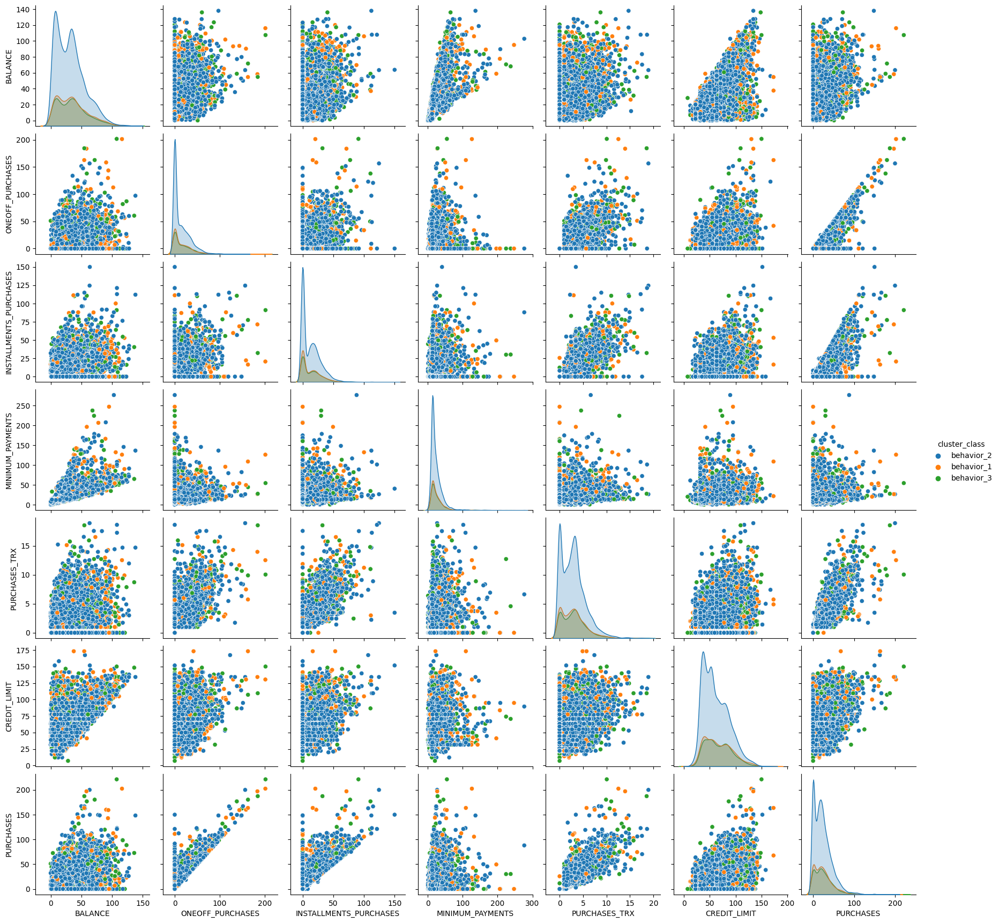

In [137]:
model_result_pairplot(cluster, "cluster_class")

In [140]:
model_result_linepolar(cluster, "cluster_class")

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\newth\AppData\Roaming\Python\Python39\site-packages\plotly\express\_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

